## Aula 4 - Filtragem Espacial (parte 1)

### 4.1 Convolução

Vamos importar as bibliotecas necessárias:

In [1]:
%matplotlib inline
import cv2 # OpenCV
import matplotlib.pyplot as plt # Matplotlib
import numpy as np # Numpy
from scipy import ndimage
from google.colab.patches import cv2_imshow # for image display


Nesse exemplo, iremos usar o scipy pela primeira vez. O scipy é uma biblioteca para cálculos científicos em python. Bibliotecas como o numpy e bibliotecas de processamento de imagens possuem módulos de convolução, porém o do scipy é o mais otimizado e suporta diferentes configurações de matrizes.

Abaixo nós temos duas matrizes 3x3 e queremos o resultado da convolução dela. Vejamos o resultado no scipy:

In [2]:
x = np.array([[2, 3, 1], [0, 5, 1], [1, 0, 8]])
y = np.array([[0, -1, 0], [-1, 5, -1], [0, -1, 0]])

print(x.shape, y.shape)

ndimage.convolve(x, y, mode="constant", cval=0)

(3, 3) (3, 3)


array([[  7,   7,   1],
       [ -8,  21,  -9],
       [  5, -14,  39]])

Precisamos definir o modo como constante para que qualquer valor que esteja fora dos limites da matriz de entrada seja considerado como zero. Existem várias outros modos de convolução, que estão bem explicados na documentação  do [ndimage.convolve()](https://docs.scipy.org/doc/scipy/reference/generated/scipy.ndimage.convolve.html)
Vamos ver agora o resultado para a convolução com o NumPy:

In [3]:
np.convolve(x, y, mode="valid")

ValueError: ignored

Ao abrirmos a documentação do [np.convolve()](http://lagrange.univ-lyon1.fr/docs/numpy/1.11.0/reference/generated/numpy.convolve.html), vemos que ele apenas aceita vetores 1D. Para convoluções gerais, bibliotecas como o SciPy são mais recomendadas. Para uso em imagens, o OpenCV ou o scikit-image deve ser usado.

Ou, se preferir, podemos escrever o nosso próprio método:

In [4]:
def convoluir(matriz, kernel):
    matriz_borda = np.zeros((matriz.shape[0] + 2, matriz.shape[1] + 2))
    matriz_borda[1:-1, 1:-1] = matriz
    saida = np.zeros_like(matriz)
    for x in range(matriz.shape[1]):
        for y in range(matriz.shape[0]):
            saida[y, x] = (kernel * matriz_borda[y:y + 3, x:x + 3]).sum()
    return saida

convoluir(x, y)

array([[  7,   7,   1],
       [ -8,  21,  -9],
       [  5, -14,  39]])

Mas essa ideia geralmente não é tão boa, principalmente por questões de desempenho. Podemos comparar abaixo a diferença de desempenho entre o nosso método e o método do scipy:

In [6]:
%timeit -n 30 -r 3 convoluir(x, y)
%timeit -n 30 -r 3 ndimage.convolve(x, y, mode="constant", cval=0)

30 loops, best of 3: 108 µs per loop
30 loops, best of 3: 65.5 µs per loop


Vimos em aula que a convolução é usada para gerar filtros. Vamos trabalhar com alguns desses filtros.

### 4.2 Filtros

Vamos começar baixando a nossa imagem da Lenna e carregando a mesma:

In [8]:
!wget https://raw.githubusercontent.com/wlcosta/es235_pdi/master/utils/lenna.jpg

--2021-06-01 17:55:44--  https://raw.githubusercontent.com/wlcosta/es235_pdi/master/utils/lenna.jpg
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 473831 (463K) [image/jpeg]
Saving to: ‘lenna.jpg’

lenna.jpg           100%[===================>] 462.73K  --.-KB/s    in 0.09s   

2021-06-01 17:55:45 (5.05 MB/s) - ‘lenna.jpg’ saved [473831/473831]



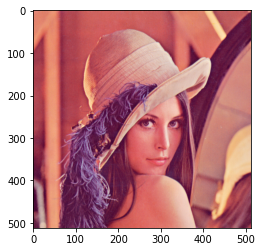

In [9]:
img = plt.imread('lenna.jpg')
plt.imshow(img)

#### 4.2.1 Filtro de médias simples

Vamos começar com o filtro mais simples. Este kernel tem um  efeito de média, dando como resposta uma imagem suavizada.

Começaremos a usar o OpenCV para trabalhar com imagens, por causa da robustez e do foco da disciplina. O método [filter2D()](https://docs.opencv.org/3.1.0/d4/d86/group__imgproc__filter.html#ga27c049795ce870216ddfb366086b5a04) aplica filtros genéricos a uma imagem qualquer.

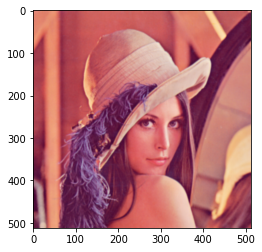

In [10]:
k_size = 3
kernel = np.ones((k_size, k_size), dtype="float32")/(k_size * k_size) # kernel de um filtro de media
img_borrada = cv2.filter2D(img, -1, kernel)
plt.imshow(img_borrada)

A princípio, não conseguimos notar tanta diferença. Isso é devido ao tamanho do kernel, que é pequeno. Que tal tentarmos algo mais agressivo? Para isso, implemente um filtro de média, da mesma forma que a célula anterior, porém aplicando um kernel de dimensão (5, 5)

100842304


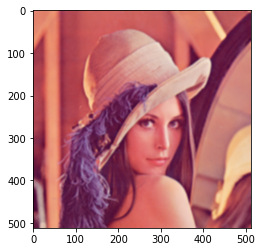

In [21]:
kernel = None
img_borrada = None
plt.imshow(img_borrada)

In [22]:
# Correção do exercício
if np.sum(img_borrada) == 100842304:
  print('Correto')
else:
  print('Revisar o código da conversão')

Correto


Agora já conseguimos ver melhor o borrão. Vamos ver outras configurações:

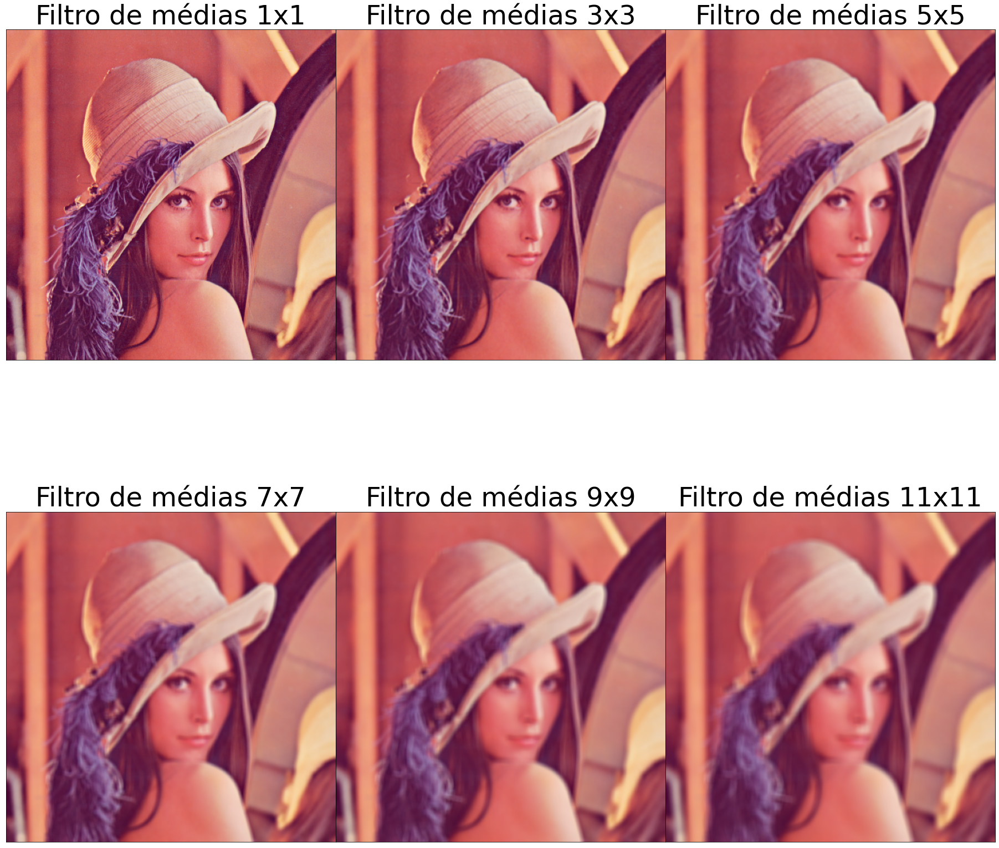

In [11]:
fig, ax = plt.subplots(2, 3, figsize=(32, 32))
fig.subplots_adjust(hspace=0, wspace=0)
kernels = np.arange(1, 13, 2)
cnt = 0

for u in range(2):
    for i in range(3):
       
        k = kernels[cnt]
        kernel = np.ones((k, k), dtype="float32")/(k*k)             
        
        ax[u, i].xaxis.set_major_locator(plt.NullLocator())
        ax[u, i].yaxis.set_major_locator(plt.NullLocator())
        cnt+=1
        ax[u, i].set_title("Filtro de médias %dx%d" % (k, k), fontsize=48)
        ax[u, i].imshow(cv2.filter2D(img, -1, kernel))

#### 4.2.2 Filtro de aguçamento (sharpening)

Nas imagens, as bordas de entre os objetos são percebidos por conta da mudança de intensidade dos pixels. O filtro de sharpening é usado para acentuar as bordas da imagem. Alguns kernels diferentes estão disponíveis, todos servindo o propósito.

Primeiro, vamos ver o filtro que foi usado durante a aula:

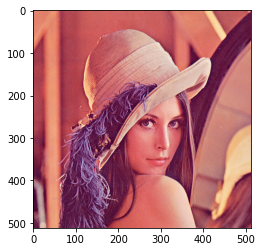

In [15]:
a = np.array(([0, 0, 0], [0, 2, 0], [0, 0, 0]))
b = np.array(([1/9, 1/9, 1/9], [1/9, 1/9, 1/9], [1/9, 1/9, 1/9]))

kernel = a - b
img_sharpen = cv2.filter2D(img, -1, kernel)
plt.imshow(img_sharpen)

Alguns outros kernels:

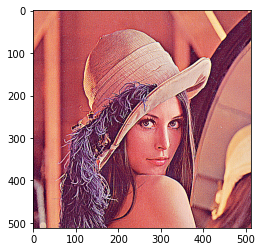

In [16]:
kernel = np.array([[-1,-1,-1],
                   [-1, 9,-1],
                   [-1,-1,-1]])
img_sharpen = cv2.filter2D(img, -1, kernel)
plt.imshow(img_sharpen)

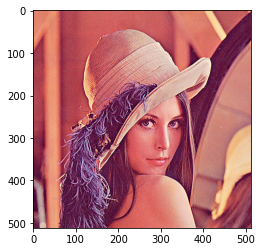

In [20]:
kernel = np.array([[0, -1, 0],
                   [-1, 5,-1],
                   [0, -1, 0]])
img_sharpen = cv2.filter2D(img, -1, kernel)
plt.imshow(img_sharpen)

Comparando os três:

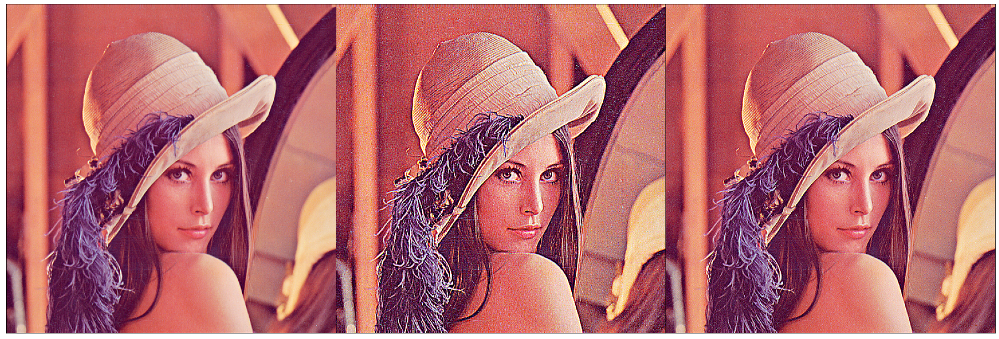

In [18]:
fig, ax = plt.subplots(1, 3, figsize=(32, 32))
fig.subplots_adjust(hspace=0, wspace=0)
kernels = [a-b, np.array([[-1,-1,-1],[-1, 9,-1],[-1,-1,-1]]), np.array([[0,-1,0],[-1, 5, -1],[0,-1,0]])]
cnt = 0

for i in range(3):
       
    k = kernels[cnt]
    img_sharpen = cv2.filter2D(img, -1, k)         
        
    ax[i].xaxis.set_major_locator(plt.NullLocator())
    ax[i].yaxis.set_major_locator(plt.NullLocator())
    cnt+=1
        
    ax[i].imshow(cv2.filter2D(img, -1, k))

#### 4.2.3 Filtro Gaussiano

O Filtro Gaussiano também é usado para suavização de imagens. O OpenCV já tem uma função pronta, chamada [GaussianBlur()](https://docs.opencv.org/3.1.0/d4/d86/group__imgproc__filter.html#gaabe8c836e97159a9193fb0b11ac52cf1), pra evitar que o usuário precise digitar toda a matriz do kernel gaussiano.

Porém, algumas aproximações são dadas com a função [getGaussianKernel()](https://docs.opencv.org/3.1.0/d4/d86/group__imgproc__filter.html#gac05a120c1ae92a6060dd0db190a61afa). Vamos comparar as duas abordagens:

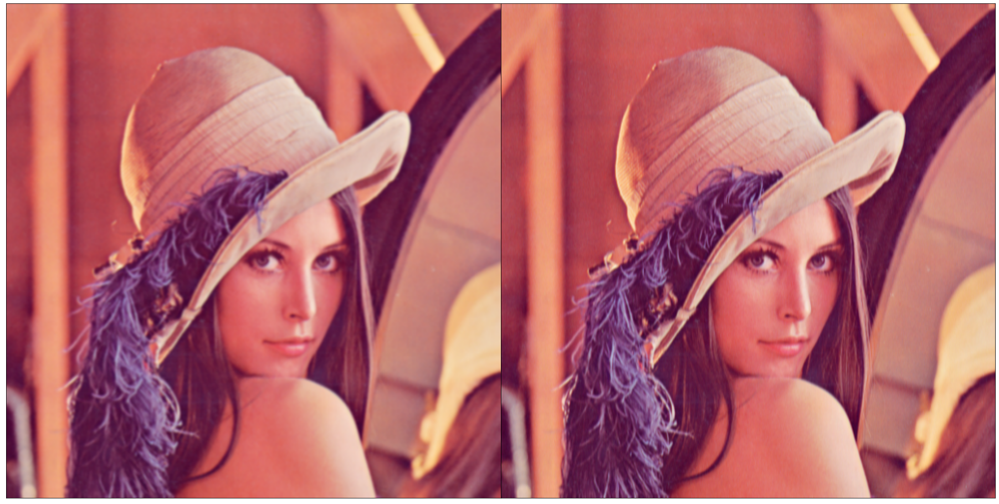

In [21]:
imagem_borrada = cv2.GaussianBlur(img, (5,5), 0)
imagem_borrada_2 = cv2.filter2D(img, -1, cv2.getGaussianKernel(ksize=5, sigma=0))
fig, ax = plt.subplots(1, 2, figsize=(32, 32))
fig.subplots_adjust(hspace=0, wspace=0)

ax[0].xaxis.set_major_locator(plt.NullLocator())
ax[0].yaxis.set_major_locator(plt.NullLocator())
ax[0].imshow(imagem_borrada)

ax[1].xaxis.set_major_locator(plt.NullLocator())
ax[1].yaxis.set_major_locator(plt.NullLocator())
ax[1].imshow(imagem_borrada_2)

Podemos ver que os resultados são bem parecidos, mas não são iguais, mesmo tendo as mesmas configurações.

Usar o método padrão do OpenCV é mais recomendado, pois é mais fácil de ter seus parâmetros configurados e também é mais otimizado:

In [28]:
%timeit -n 30 -r 5 cv2.GaussianBlur(img, (5,5), 0)
k = cv2.getGaussianKernel(ksize=5, sigma=0)
%timeit -n 30 -r 5 cv2.filter2D(img, -1, k)

30 loops, best of 5: 927 µs per loop
30 loops, best of 5: 955 µs per loop


#### 4.2.4 Filtro de Mediana

Este filtro é bem efetivo na remoção do ruído *salt-and-pepper* em uma imagem. Vamos adicionar ruído na imagem de Lenna e fazer um teste. Para isso, vamos usar o método [random_noise()](http://scikit-image.org/docs/dev/api/skimage.util.html#skimage.util.random_noise) do scikit-image. Esse método permite vários modos, vamos testar primeiro com o gaussiano.

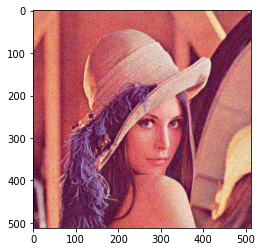

In [30]:
from skimage.util import random_noise
img_ruido = random_noise(img, mode='gaussian')
plt.imshow(img_ruido)

O OpenCV nos fornece um método, chamado [medianBlur](https://docs.opencv.org/master/d4/d86/group__imgproc__filter.html#ga564869aa33e58769b4469101aac458f9), para suavizar a imagem usando um filtro de média.

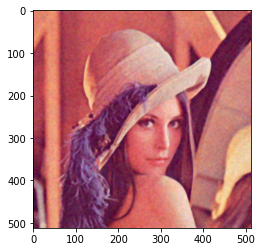

In [32]:
img_mediana = cv2.medianBlur(np.float32(img_ruido), 5)
plt.imshow(img_mediana)

Vamos testar os outros ruídos e mostrar uma comparação lado a lado:

In [41]:
ruidos = ['gaussian', 'localvar', 'poisson', 'salt', 'pepper', 's&p', 'speckle']
cnt = 0

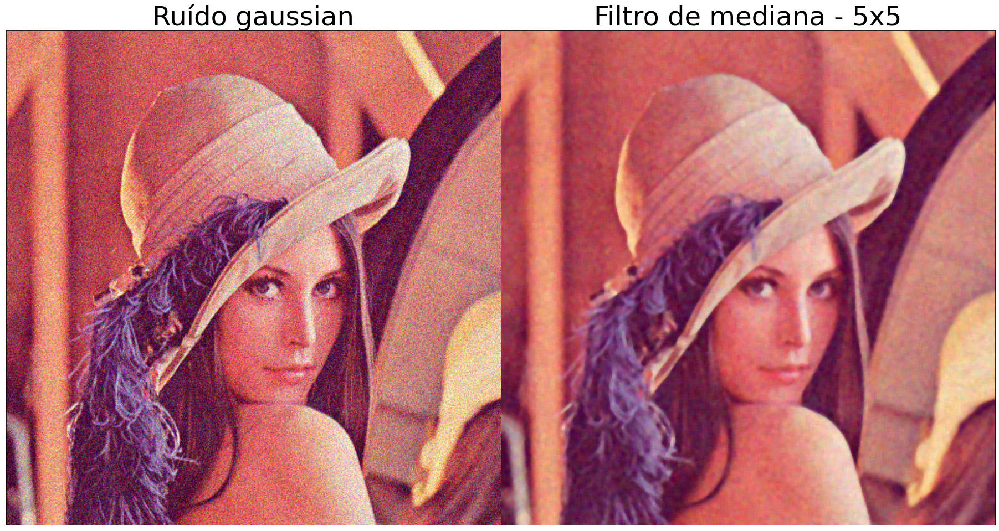

In [42]:
fig, ax = plt.subplots(1, 2, figsize=(32, 32))
fig.subplots_adjust(hspace=0, wspace=0)

ax[0].xaxis.set_major_locator(plt.NullLocator())
ax[0].yaxis.set_major_locator(plt.NullLocator())
img_ruido = random_noise(img, ruidos[cnt])
ax[0].imshow(img_ruido)
ax[0].set_title("Ruído %s" % (ruidos[cnt]), fontsize=48)
                         
ax[1].xaxis.set_major_locator(plt.NullLocator())
ax[1].yaxis.set_major_locator(plt.NullLocator())
img_mediana = cv2.medianBlur(np.float32(img_ruido), 5)
ax[1].set_title("Filtro de mediana - %dx%d" % (5, 5), fontsize=48)
ax[1].imshow(img_mediana)

cnt += 1

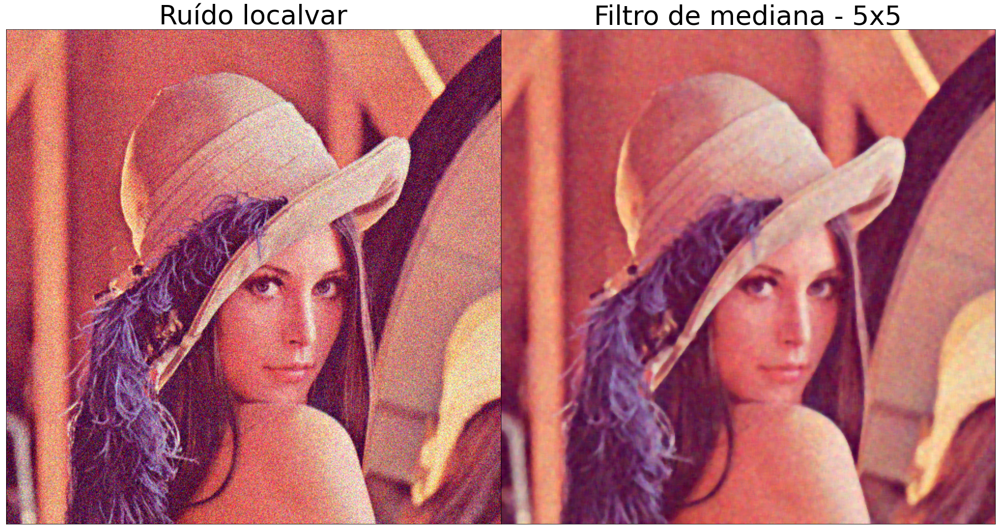

In [43]:
fig, ax = plt.subplots(1, 2, figsize=(32, 32))
fig.subplots_adjust(hspace=0, wspace=0)

ax[0].xaxis.set_major_locator(plt.NullLocator())
ax[0].yaxis.set_major_locator(plt.NullLocator())
img_ruido = random_noise(img, ruidos[cnt])
ax[0].imshow(img_ruido)
ax[0].set_title("Ruído %s" % (ruidos[cnt]), fontsize=48)
                         
ax[1].xaxis.set_major_locator(plt.NullLocator())
ax[1].yaxis.set_major_locator(plt.NullLocator())
img_mediana = cv2.medianBlur(np.float32(img_ruido), 5)
ax[1].set_title("Filtro de mediana - %dx%d" % (5, 5), fontsize=48)
ax[1].imshow(img_mediana)

cnt += 1

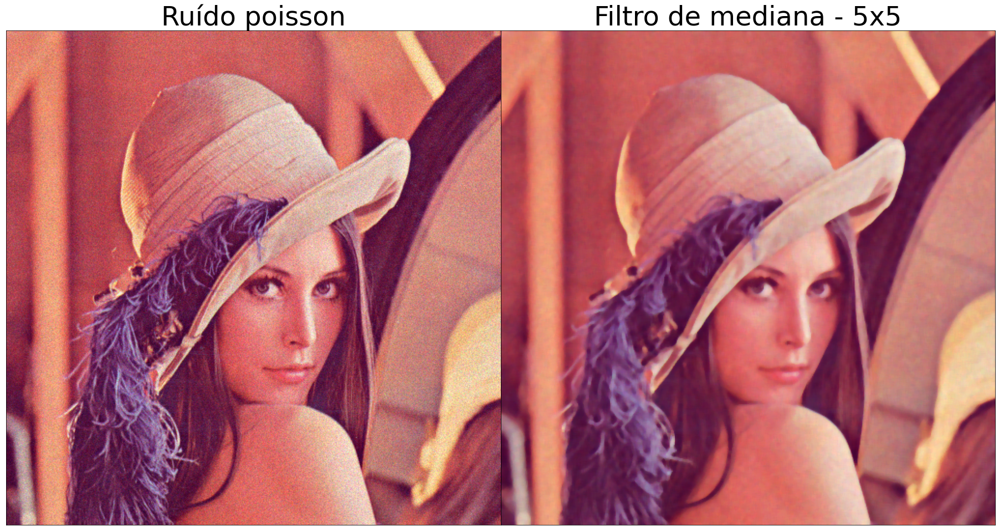

In [44]:
fig, ax = plt.subplots(1, 2, figsize=(32, 32))
fig.subplots_adjust(hspace=0, wspace=0)

ax[0].xaxis.set_major_locator(plt.NullLocator())
ax[0].yaxis.set_major_locator(plt.NullLocator())
img_ruido = random_noise(img, ruidos[cnt])
ax[0].imshow(img_ruido)
ax[0].set_title("Ruído %s" % (ruidos[cnt]), fontsize=48)
                         
ax[1].xaxis.set_major_locator(plt.NullLocator())
ax[1].yaxis.set_major_locator(plt.NullLocator())
img_mediana = cv2.medianBlur(np.float32(img_ruido), 5)
ax[1].set_title("Filtro de mediana - %dx%d" % (5, 5), fontsize=48)
ax[1].imshow(img_mediana)

cnt += 1

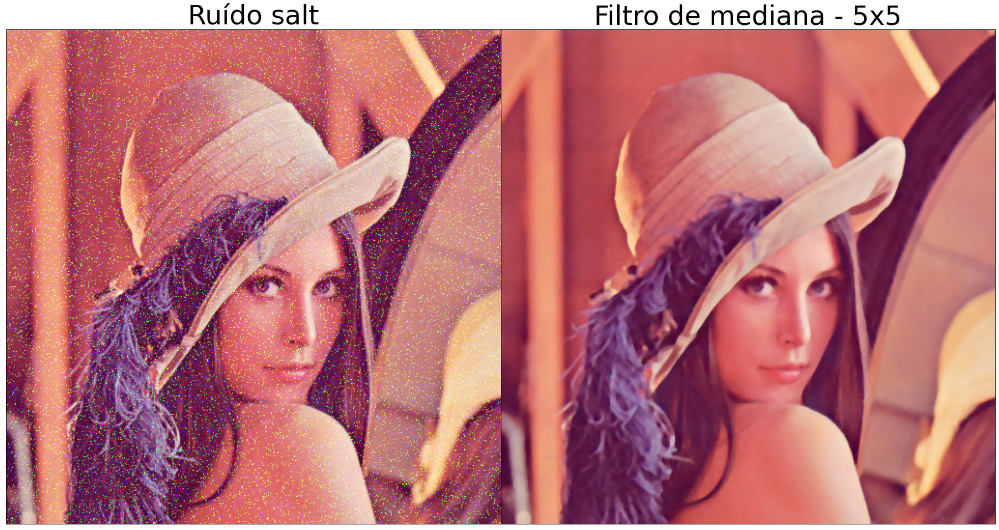

In [45]:
fig, ax = plt.subplots(1, 2, figsize=(32, 32))
fig.subplots_adjust(hspace=0, wspace=0)

ax[0].xaxis.set_major_locator(plt.NullLocator())
ax[0].yaxis.set_major_locator(plt.NullLocator())
img_ruido = random_noise(img, ruidos[cnt])
ax[0].imshow(img_ruido)
ax[0].set_title("Ruído %s" % (ruidos[cnt]), fontsize=48)
                         
ax[1].xaxis.set_major_locator(plt.NullLocator())
ax[1].yaxis.set_major_locator(plt.NullLocator())
img_mediana = cv2.medianBlur(np.float32(img_ruido), 5)
ax[1].set_title("Filtro de mediana - %dx%d" % (5, 5), fontsize=48)
ax[1].imshow(img_mediana)

cnt += 1

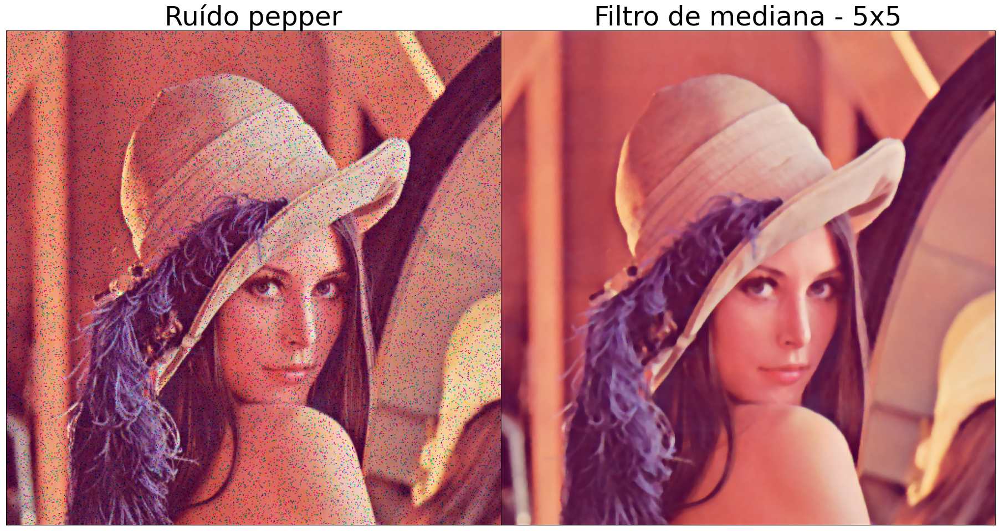

In [46]:
fig, ax = plt.subplots(1, 2, figsize=(32, 32))
fig.subplots_adjust(hspace=0, wspace=0)

ax[0].xaxis.set_major_locator(plt.NullLocator())
ax[0].yaxis.set_major_locator(plt.NullLocator())
img_ruido = random_noise(img, ruidos[cnt])
ax[0].imshow(img_ruido)
ax[0].set_title("Ruído %s" % (ruidos[cnt]), fontsize=48)
                         
ax[1].xaxis.set_major_locator(plt.NullLocator())
ax[1].yaxis.set_major_locator(plt.NullLocator())
img_mediana = cv2.medianBlur(np.float32(img_ruido), 5)
ax[1].set_title("Filtro de mediana - %dx%d" % (5, 5), fontsize=48)
ax[1].imshow(img_mediana)

cnt += 1

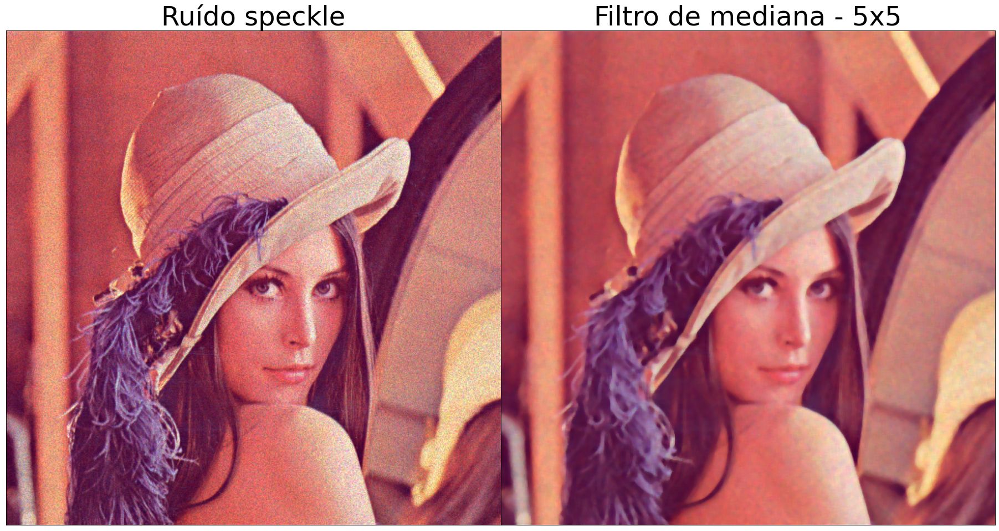

In [48]:
fig, ax = plt.subplots(1, 2, figsize=(32, 32))
fig.subplots_adjust(hspace=0, wspace=0)

ax[0].xaxis.set_major_locator(plt.NullLocator())
ax[0].yaxis.set_major_locator(plt.NullLocator())
img_ruido = random_noise(img, ruidos[cnt])
ax[0].imshow(img_ruido)
ax[0].set_title("Ruído %s" % (ruidos[cnt]), fontsize=48)
                         
ax[1].xaxis.set_major_locator(plt.NullLocator())
ax[1].yaxis.set_major_locator(plt.NullLocator())
img_mediana = cv2.medianBlur(np.float32(img_ruido), 5)
ax[1].set_title("Filtro de mediana - %dx%d" % (5, 5), fontsize=48)
ax[1].imshow(img_mediana)

cnt += 1

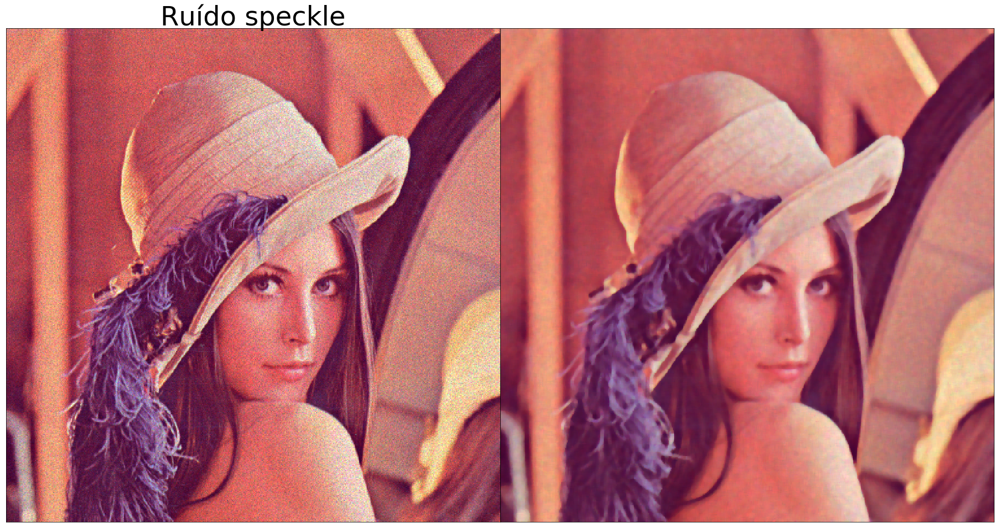

In [ ]:
}fig, ax = plt.subplots(1, 2, figsize=(32, 32))
fig.subplots_adjust(hspace=0, wspace=0)

ax[0].xaxis.set_major_locator(plt.NullLocator())
ax[0].yaxis.set_major_locator(plt.NullLocator())
img_ruido = random_noise(img, ruidos[cnt])
ax[0].imshow(img_ruido)
ax[0].set_title("Ruído %s" % (ruidos[cnt]), fontsize=48)
                         
ax[1].xaxis.set_major_locator(plt.NullLocator())
ax[1].yaxis.set_major_locator(plt.NullLocator())
img_mediana = cv2.medianBlur(np.float32(img_ruido), 5)
ax[1].set_title("Filtro de mediana - %dx%d" % (5, 5), fontsize=48)
ax[1].imshow(img_mediana)

cnt += 1